The objective of this project is to use predictive algorithms to forecast the energy consumption of a steel industry based on the current conditions of independent variables. The developed regression model will be a real-time decision support tool, allowing monitoring and control of production processes based on the conditions of independent variables and energy consumption goals. This will help maximize energy efficiency, minimize waste, and ensure optimized resource utilization in the steel industry.

The project has been divided into nine stages: setup, dataset acquisition, data exploration, transformers, pipeline creation, model training, hyperparameter tuning, and model validation.


# Setup

In the setup stage, all necessary libraries are imported for the project, and the directory where analysis results will be saved is defined. A function is also created to save each image.

In [ ]:
# import librarys
import sys
import sklearn
import numpy as np
import os
import pandas as pd
import datetime as dt
import os
import gdown
from sklearn.ensemble import IsolationForest
from scipy.stats import pearsonr
from sklearn.impute import SimpleImputer
from sklearn.base import BaseEstimator, TransformerMixin
from pandas.plotting import scatter_matrix
from sklearn.model_selection import StratifiedShuffleSplit, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import FeatureUnion
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
import xgboost
from sklearn.model_selection import GridSearchCV
import warnings

# To plot pretty figures
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
%config InlineBackend.figure_format = 'retina'

mpl.rc('axes', labelsize = 14)
mpl.rc('xtick', labelsize = 12)
mpl.rc('ytick', labelsize = 12)

# Where to save the figures
project_root_dir = "."
chapter_id = "Steel Industry Energy Consumption"
images_path = os.path.join(project_root_dir, "images", chapter_id)
os.makedirs(images_path, exist_ok = True)

def save_fig(fig_id, tight_layout = True, fig_extension = "png", resolution = 300):
    path = os.path.join(images_path, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format = fig_extension, dpi = resolution)

# Dataset

In the dataset acquisition process, the dataset is downloaded to a specific directory. Then, the file is read and explored, and variables are renamed for easier manipulation.

In [ ]:
data_path = os.path.join("datasets", "SteelIndustry")
data_url = "https://docs.google.com/spreadsheets/d/e/2PACX-1vR-ZP8RZp6ftgRZWCPdJIXtdOosPPILHFIGGKkESlsQVolZDNeZYS65uGJxFmx-vRxenIZHQNCHxYN-/pub?output=csv"
archive_name = "SteelIndustryEnergyConsumption_googledrive.csv"

def fetch_data(data_url = data_url, data_path = data_path, archive_name = archive_name):
    if not os.path.isdir(data_path):
        os.makedirs(data_path)
    csv_path = os.path.join(data_path, archive_name)
    gdown.download(data_url, csv_path, quiet=False)

In [ ]:
fetch_data()

C:\Users\Claudiomar\anaconda3\lib\site-packages\gdown\parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(
Downloading...
From: https://docs.google.com/spreadsheets/d/e/2PACX-1vR-ZP8RZp6ftgRZWCPdJIXtdOosPPILHFIGGKkESlsQVolZDNeZYS65uGJxFmx-vRxenIZHQNCHxYN-/pub?output=csv
To: D:\Desktop\Jupyter\Aprendizado de Máquina\Portfólio\Steel Industry Energy Consumption\datasets\SteelIndustry\SteelIndustryEnergyConsumption_googledrive.csv
2.73MB [00:00, 3.02MB/s]


In [ ]:
def load_data(data_path = data_path, archive_name = archive_name):
    csv_path = os.path.join(data_path, archive_name)
    return pd.read_csv(csv_path)

In [ ]:
steel = load_data(data_path = data_path, archive_name = archive_name)
steel.head(10)

,date,Usage_kWh,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Day_of_week,Load_Type
0,01/01/2018 00:15,3.17,2.95,0.0,0.0,73.21,100.0,900,Weekday,Monday,Light_Load
1,01/01/2018 00:30,4.00,4.46,0.0,0.0,66.77,100.0,1800,Weekday,Monday,Light_Load
2,01/01/2018 00:45,3.24,3.28,0.0,0.0,70.28,100.0,2700,Weekday,Monday,Light_Load
3,01/01/2018 01:00,3.31,3.56,0.0,0.0,68.09,100.0,3600,Weekday,Monday,Light_Load
4,01/01/2018 01:15,3.82,4.50,0.0,0.0,64.72,100.0,4500,Weekday,Monday,Light_Load
5,01/01/2018 01:30,3.28,3.56,0.0,0.0,67.76,100.0,5400,Weekday,Monday,Light_Load
6,01/01/2018 01:45,3.60,4.14,0.0,0.0,65.62,100.0,6300,Weekday,Monday,Light_Load
7,01/01/2018 02:00,3.60,4.28,0.0,0.0,64.37,100.0,7200,Weekday,Monday,Light_Load
8,01/01/2018 02:15,3.28,3.64,0.0,0.0,66.94,100.0,8100,Weekday,Monday,Light_Load
9,01/01/2018 02:30,3.78,4.72,0.0,0.0,62.51,100.0,9000,Weekday,Monday,Light_Load


The variables in the dataset are as follows:

- "Date": represents the date when the data was recorded. It is a continuous time variable usually registered on the first day of each month.
- "Consumption": indicates the energy consumption of the industry in kilowatt-hours (kWh). It represents the amount of electrical energy used by the steel industry during the considered time period.
- "LaggingCurRP": occurs when reactive power lags behind active power. This means that reactive power is delayed in relation to active power, usually due to the presence of inductive elements such as electric motors and transformers. These elements consume lagging reactive power to create magnetic fields and perform their functions.
- "LeadingCurRP": occurs when reactive power leads active power. This means that reactive power is advanced in relation to active power, usually due to the presence of capacitive elements such as capacitors. These elements provide leading reactive power to compensate for the lag caused by inductive elements and improve the power factor of the system.
- "LaggCurPF": (lagging power factor) occurs when reactive power lags behind active power. This usually happens when there are inductive components in the system, such as electric motors and transformers.
- "LeadCurPF": (leading power factor) occurs when reactive power leads active power. This happens when there are capacitive components in the system, such as capacitors.
- "tCO2": measures the amount of carbon dioxide (CO2) emitted during the steelmaking process, usually expressed in parts per million (ppm). It is an important indicator of the environmental impact associated with steel production.
- "NSM": represents the number of seconds elapsed since midnight. This continuous variable can be useful for analyzing energy consumption patterns throughout the day.
- "WeekStatus": indicates whether the day in question is a weekend (0) or a weekday (1). This can be useful for observing different energy consumption patterns between weekdays and weekends.
- "DayWeek": indicates the day of the week when the data was recorded, from Sunday to Saturday. It can also be useful for analyzing weekly patterns in energy consumption.
- "LoadType": indicates the type of load in terms of light load, medium load, and heavy load. This categorical variable can be used to categorize different types of loads.

In [ ]:
column = ["Date", "Consumption", "LaggCurRP", "LeadCurRP", "tCO2", "LaggCurPF", "LeadCurPF", "NSM", "WeekStatus", "DayWeek", "LoadType"]

steel.columns = column

steel.head(10)

,Date,Consumption,LaggCurRP,LeadCurRP,tCO2,LaggCurPF,LeadCurPF,NSM,WeekStatus,DayWeek,LoadType
0,01/01/2018 00:15,3.17,2.95,0.0,0.0,73.21,100.0,900,Weekday,Monday,Light_Load
1,01/01/2018 00:30,4.00,4.46,0.0,0.0,66.77,100.0,1800,Weekday,Monday,Light_Load
2,01/01/2018 00:45,3.24,3.28,0.0,0.0,70.28,100.0,2700,Weekday,Monday,Light_Load
3,01/01/2018 01:00,3.31,3.56,0.0,0.0,68.09,100.0,3600,Weekday,Monday,Light_Load
4,01/01/2018 01:15,3.82,4.50,0.0,0.0,64.72,100.0,4500,Weekday,Monday,Light_Load
5,01/01/2018 01:30,3.28,3.56,0.0,0.0,67.76,100.0,5400,Weekday,Monday,Light_Load
6,01/01/2018 01:45,3.60,4.14,0.0,0.0,65.62,100.0,6300,Weekday,Monday,Light_Load
7,01/01/2018 02:00,3.60,4.28,0.0,0.0,64.37,100.0,7200,Weekday,Monday,Light_Load
8,01/01/2018 02:15,3.28,3.64,0.0,0.0,66.94,100.0,8100,Weekday,Monday,Light_Load
9,01/01/2018 02:30,3.78,4.72,0.0,0.0,62.51,100.0,9000,Weekday,Monday,Light_Load


# Data Exploration

In the data exploration stage, categorical variables are selected, and an individual analysis is performed for each of them. Then, the ".info()" function is used to check the data structure, and the ".describe()" function provides a descriptive statistical summary of each variable. The correlation between each numerical variable and the target variable "Consumption" is calculated and displayed in a heatmap, along with a matrix of scatter plots to visualize the relationships between numerical variables. Histograms and box plots are plotted to better understand the distribution and presence of outliers in the data

In [ ]:
steel_cat = steel.select_dtypes(include = [np.object_])

for column in steel_cat.columns:
    print(column, " has the following factors:", steel_cat[column].unique(), "\n")

Date  has the following factors: ['01/01/2018 00:15' '01/01/2018 00:30' '01/01/2018 00:45' ...
 '31/12/2018 23:30' '31/12/2018 23:45' '31/12/2018 00:00'] 

WeekStatus  has the following factors: ['Weekday' 'Weekend'] 

DayWeek  has the following factors: ['Monday' 'Tuesday' 'Wednesday' 'Thursday' 'Friday' 'Saturday' 'Sunday'] 

LoadType  has the following factors: ['Light_Load' 'Medium_Load' 'Maximum_Load'] 



In [ ]:
steel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Date         35040 non-null  object 
 1   Consumption  35040 non-null  float64
 2   LaggCurRP    35040 non-null  float64
 3   LeadCurRP    35040 non-null  float64
 4   tCO2         35040 non-null  float64
 5   LaggCurPF    35040 non-null  float64
 6   LeadCurPF    35040 non-null  float64
 7   NSM          35040 non-null  int64  
 8   WeekStatus   35040 non-null  object 
 9   DayWeek      35040 non-null  object 
 10  LoadType     35040 non-null  object 
dtypes: float64(6), int64(1), object(4)
memory usage: 2.9+ MB


In [ ]:
steel.describe()

,Consumption,LaggCurRP,LeadCurRP,tCO2,LaggCurPF,LeadCurPF,NSM
count,35040.000000,35040.000000,35040.000000,35040.000000,35040.000000,35040.000000,35040.000000
mean,27.386892,13.035384,3.870949,0.011524,80.578056,84.367870,42750.000000
std,33.444380,16.306000,7.424463,0.016151,18.921322,30.456535,24940.534317
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.200000,2.300000,0.000000,0.000000,63.320000,99.700000,21375.000000
50%,4.570000,5.000000,0.000000,0.000000,87.960000,100.000000,42750.000000
75%,51.237500,22.640000,2.090000,0.020000,99.022500,100.000000,64125.000000
max,157.180000,96.910000,27.760000,0.070000,100.000000,100.000000,85500.000000


In [ ]:
corr = []
p_value = []

steel_num = steel.select_dtypes(include = [np.number])

for column in steel_num.columns:
    corr_i, p_value_i = pearsonr(steel_num["Consumption"], steel_num[column])
    corr.append(round(corr_i, 4))
    p_value.append(round(p_value_i, 4))

corr_pvalue = pd.DataFrame({"Variable" : list(steel_num.columns), "Pearson Correlation Coeffcient" : corr, "P Value" : p_value})

corr_pvalue

,Variable,Pearson Correlation Coeffcient,P Value
0,Consumption,1.0000,0.0
1,LaggCurRP,0.8961,0.0
2,LeadCurRP,-0.3249,0.0
3,tCO2,0.9882,0.0
4,LaggCurPF,0.3860,0.0
5,LeadCurPF,0.3536,0.0
6,NSM,0.2346,0.0


C:\Users\Claudiomar\AppData\Local\Temp\ipykernel_8372\981197279.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = steel.corr()


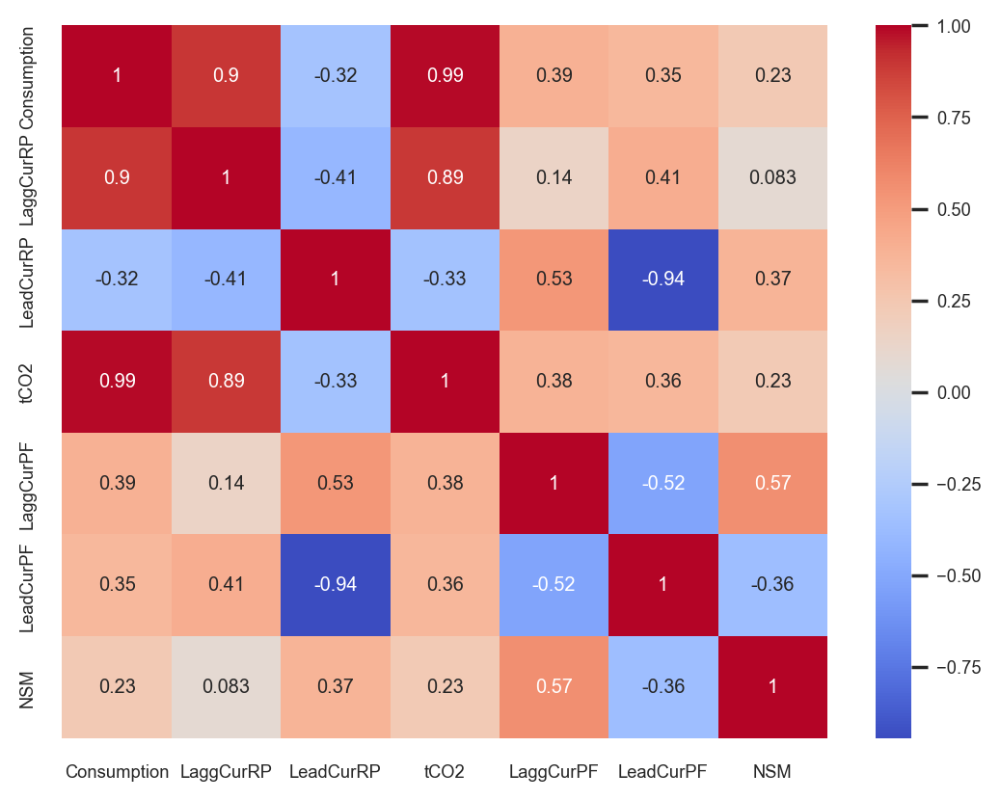

In [ ]:
corr_matrix = steel.corr()
sns.set(font_scale = 0.6)
sns.set_style("darkgrid")
sns.heatmap(corr_matrix, annot = True, cmap = "coolwarm")
plt.show()

In [ ]:
sns.set(font_scale = 3)
sns.set_style("darkgrid")
sns.set_palette("gray")
sns.pairplot(steel.select_dtypes(include = [np.float64]), diag_kind = "hist", height = 8, plot_kws = {"color": "gray"})
save_fig("scatter_matrix_plot")

Saving figure scatter_matrix_plot


Saving figure attribute_histogram_plots


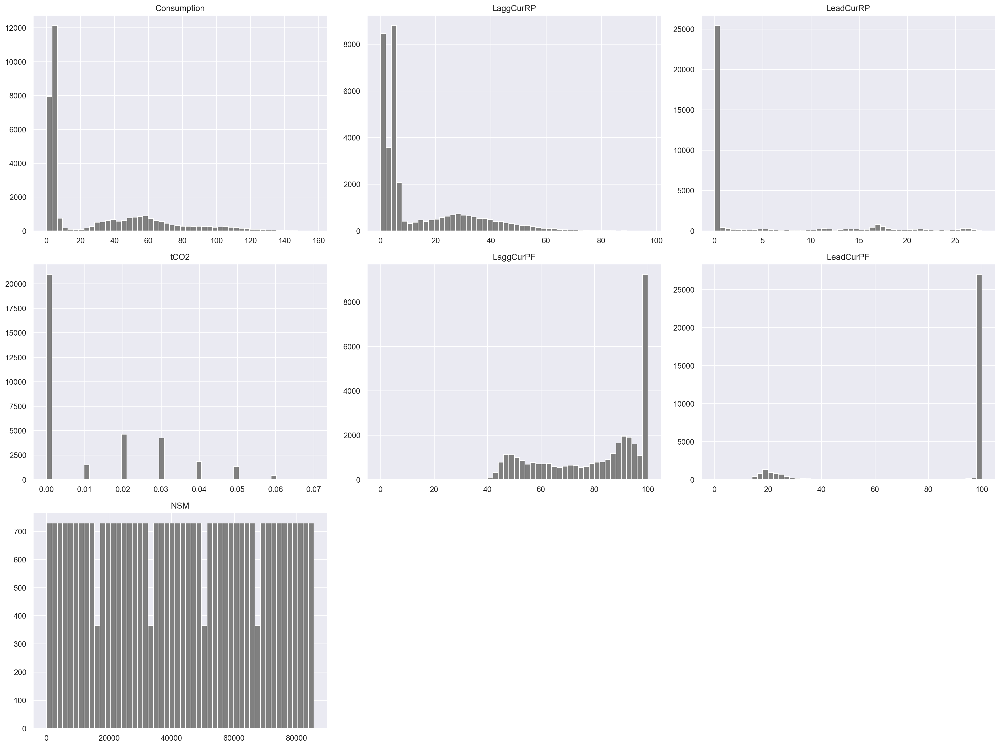

In [ ]:
sns.set()
steel.hist(bins = 50, figsize = (20,15), color = "gray")
save_fig("attribute_histogram_plots")

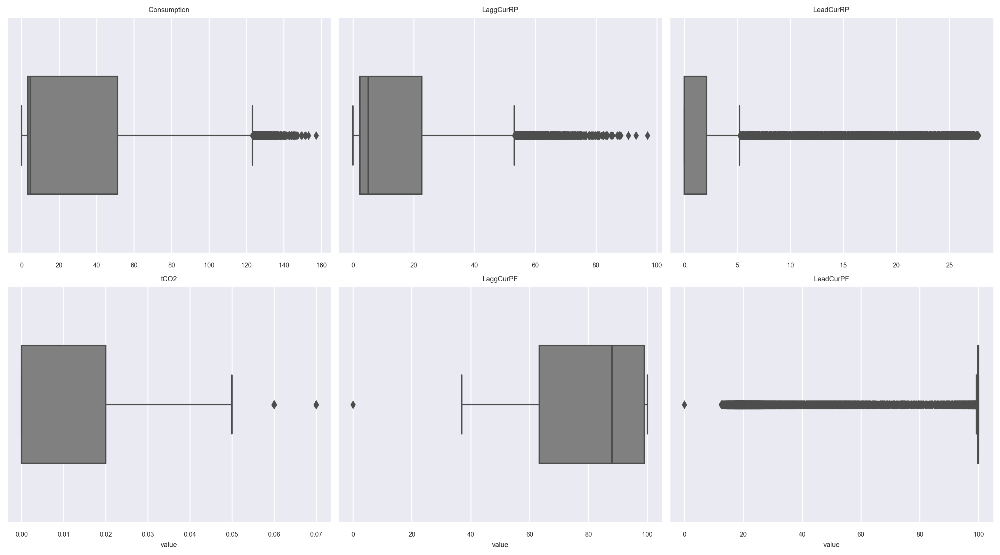

In [ ]:
sns.set(font_scale=0.6)
sns.set_style("darkgrid")
sns.set_palette("gray")

numeric_columns = steel.select_dtypes(include=[np.float64])

grid = sns.FacetGrid(pd.melt(numeric_columns), col = "variable", sharex = False, col_wrap = 3, height = 4, aspect = 1.2)
grid.map(sns.boxplot, "value", order = numeric_columns.columns, palette = "gray", width = 0.5)
grid.set_titles("{col_name}")

plt.tight_layout()
plt.show()

### Consisting variables

1. tCO2

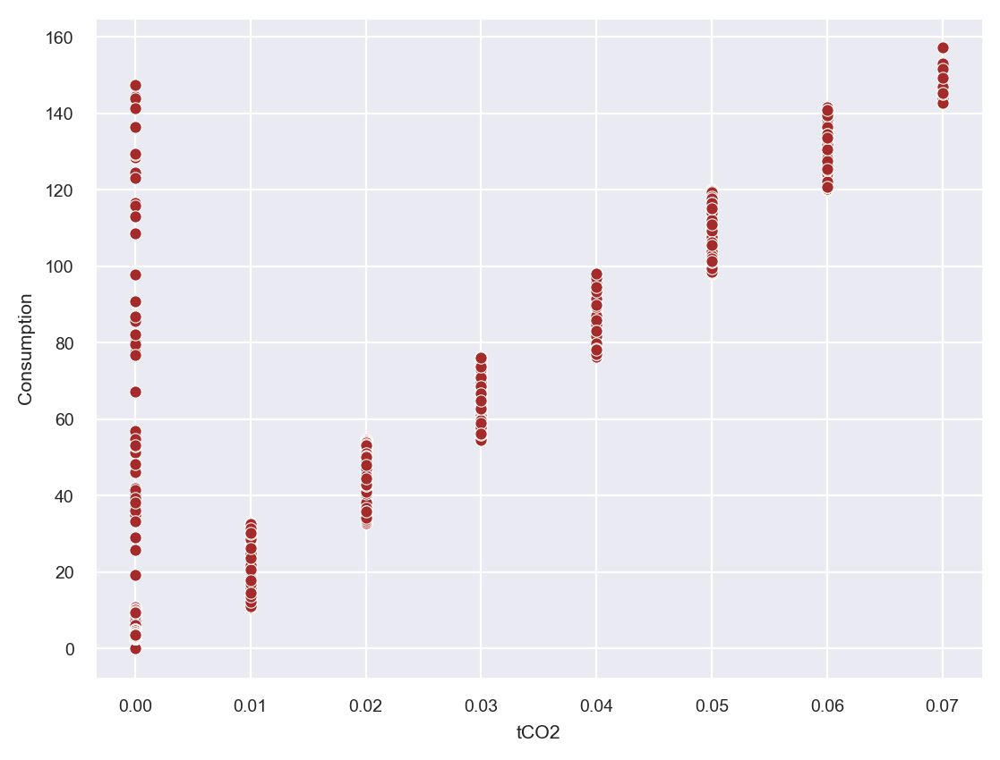

In [ ]:
sns.set_style("darkgrid")
sns.set_context("paper", font_scale = 0.8)
sns.scatterplot(x = steel["tCO2"], y = steel["Consumption"], color = "brown")
plt.xticks(np.arange(min(steel["tCO2"]), max(steel["tCO2"]) + 0.01, 0.01))
plt.show()

In [ ]:
steel_filter_tCO2 = steel.loc[steel["tCO2"] != 0]
print("Len of Original Data: ", len(steel),"\nLen of Data['tCO2'] != 0: ", len(steel_filter_tCO2))

Len of Original Data:  35040 
Len of Data['tCO2'] != 0:  14050


In [ ]:
sns.set(font_scale = 3)
sns.set_style("darkgrid")
sns.set_palette("gray")
sns.pairplot(steel_filter_tCO2.select_dtypes(include = [np.float64]), diag_kind = "hist", height = 8, plot_kws = {"color": "brown"})
plt.show()

# Split Train Test

The data is split into training and testing sets using stratified random sampling. In this case, 80% of the data is allocated for training and 20% for testing. The "tCO2" variable is used as the stratifying variable since it has a high correlation with the target variable.

In [ ]:
# creat defined  interval of classes of a important feature for a stratified random sampling
steel["tCO2_cat"] = pd.cut(steel["tCO2"],
                           bins = [0, 0.02, 0.04, 0.06, 0.08, np.inf],
                           labels = [0, 0.02, 0.04, 0.06, 0.08],
                           right = False)

# stratified random sampling
split = StratifiedShuffleSplit(n_splits = 1, test_size = 0.2, random_state=42)

for train_index, test_index in split.split(steel, steel["tCO2_cat"]):
    strat_train = steel.loc[train_index]
    strat_test = steel.loc[test_index]

In [ ]:
strat_train_set = strat_train.drop("Consumption", axis = 1)
strat_train_lab = pd.DataFrame(strat_train["Consumption"].reset_index(drop=True).copy())

# Transformers

Custom transformers are created in the transformers stage and are responsible for data processing according to the needs identified in the data exploration stage. Five transformers were developed: "OutlierRemover()" to remove outliers using the Isolation Forest algorithm, "SplitDate()" to split the date into separate columns for year, month, day, and hour, "IsNaN()" to identify missing values in the "tCO2" variable, "GroupImputer()" to perform imputation by mean, median, or any strategy from SimpleImputer() by group, and "TypeSelector()" to select categorical and/or numerical features.

In [ ]:
class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, contamination = 0.1):
        self.contamination = contamination
        self.model = IsolationForest(contamination = self.contamination)

    def fit(self, X, y=None):
        self.X_transformed = pd.DataFrame(X.copy())
        self.X_value = self.X_transformed.values
        self.model.fit(self.X_value)

        return self

    def transform(self, X, y=None):
        outlier_pred = self.model.predict(self.X_value)
        self.X_transformed["Outlier"] = outlier_pred
        self.X_transformed = self.X_transformed[self.X_transformed['Outlier'] != -1]
        self.X_transformed = self.X_transformed.drop('Outlier', axis=1)

        return self.X_transformed

In [ ]:
class SplitDate(BaseEstimator, TransformerMixin):
    def __init__(self, format_in = '%d/%m/%Y %H:%M', date = "Date"):
        self.format_in = format_in
        self.date = date

    def fit(self, X, y = None):
        return self

    def transform(self, X):
        X_transformed = X.copy()
        X_transformed["Year"] = pd.to_datetime(X_transformed[self.date], format = self.format_in).dt.year
        X_transformed["Month"] = pd.to_datetime(X_transformed[self.date], format = self.format_in).dt.month
        X_transformed["Day"] = pd.to_datetime(X_transformed[self.date], format = self.format_in).dt.day
        X_transformed["Hour"] = pd.to_datetime(X_transformed[self.date], format = self.format_in).dt.time

        X_transformed = X_transformed.drop(columns = [self.date], axis = 1)

        return X_transformed.to_numpy()

In [ ]:
class IsNaN(BaseEstimator, TransformerMixin):
    def __init__(self, target = "tCO2"):
        self.target = target

    def fit(self, X, y = None):
        return self

    def transform(self, X):
        X_transformed = X.copy()
        X_transformed["IsNaN"] =  np.where(X_transformed[self.target] != 0, 1, 0)

        return X_transformed

In [ ]:
class GroupImputer(BaseEstimator, TransformerMixin):
    def __init__(self, target = "tCO2", strategy = 'mean', groupby_cols = None):
        self.target = target
        self.groupby_cols = groupby_cols
        self.strategy = strategy
        self.imputer = SimpleImputer(strategy = self.strategy)

    def fit(self, X, y = None):
        return self

    def transform(self, X):
        X_transformed = X.copy()
        X_transformed[self.target] =  X_transformed[[self.target]].replace(0, np.nan)

        if self.groupby_cols is not None:
            X_transformed["keyOne"] = "Primary_key"
            key_group = ["keyOne", self.groupby_cols]

            for i in range(len(self.groupby_cols) - 1, 1, -1):
                key_group.append(self.groupby_cols[:-i])

            for key in key_group:
                groups = X_transformed.groupby(key)
                X_transformed[self.target] = groups[[self.target]].transform(lambda x: self.imputer.fit_transform(x.values.reshape(-1, 1)).flatten())

            X_transformed = X_transformed.drop("keyOne", axis = 1)

        else:
            X_transformed[self.target] = self.imputer.fit_transform(X_transformed[[self.target]])

        return X_transformed

In [ ]:
class TypeSelector(BaseEstimator, TransformerMixin):
    def __init__(self, variable_type = None, variable_vector = None):

        self.variable_type = variable_type
        self.variable_vector = variable_vector

        valid_types = ['cat', 'num']
        if self.variable_type not in valid_types:
            raise ValueError(f"Invalid variable type '{self.variable_type}'. Valid types are 'cat' (categorical) and 'num' (numerical).")

    def fit(self, X, y = None):
        return self

    def transform(self, X):
        X_transformed = X.copy()

        num_attribs = list(X_transformed.select_dtypes(include = [np.number]))
        cat_attribs = list(X_transformed.select_dtypes(include = [np.object_]))

        if self.variable_vector == None:
            if self.variable_type == "num":
                filter_list = num_attribs
            else:
                filter_list = cat_attribs
        else:
            if self.variable_type == "num":
                filter_list = [x for x in num_attribs if x in self.variable_vector]
                if filter_list != num_attribs:
                    warnings.warn(f"Attention, there are categorical variables in '{self.variable_vector}'. Only numeric variables were retained: '{num_attribs}'.")
            else:
                filter_list = [x for x in cat_attribs if x in self.variable_vector]
                if filter_list != cat_attribs:
                    warnings.warn(f"Attention, there are numeric variables in '{self.variable_vector}'. Only categorical variables were retained: '{cat_attribs}'.")

        X_transformed = X_transformed.filter(items = filter_list)

        return X_transformed

# Pipelines

In the pipeline creation stage, data transformation flows are defined to automate data preprocessing, including cleaning, transformation, and feature selection steps. This ensures the reproducibility of the process and facilitates applying the same steps to new datasets.

In [ ]:
cat_pipeline = Pipeline([('type_select', TypeSelector(variable_type = "cat")),
                         ('attribs_adder', SplitDate()),
                         ("onehot", OneHotEncoder(sparse_output = False))])

num_pipeline = Pipeline([('group_imputer', GroupImputer(strategy = 'mean', groupby_cols = ["LoadType", "WeekStatus", "DayWeek"])),
                         ('type_select', TypeSelector(variable_type = "num")),
                         ("is_nan", IsNaN())])

In [ ]:
uni_pipeline = FeatureUnion([("num", num_pipeline),
                              ("cat", cat_pipeline)])

In [ ]:
full_pipeline = Pipeline([('full_pipeline', uni_pipeline),
                          ('Remove Outliers', OutlierRemover()),
                          ('std_scaler', StandardScaler())])

In [ ]:
full_pipeline

Pipeline(steps=[('full_pipeline',
                 FeatureUnion(transformer_list=[('num',
                                                 Pipeline(steps=[('group_imputer',
                                                                  GroupImputer(groupby_cols=['LoadType',
                                                                                             'WeekStatus',
                                                                                             'DayWeek'])),
                                                                 ('type_select',
                                                                  TypeSelector(variable_type='num')),
                                                                 ('is_nan',
                                                                  IsNaN())])),
                                                ('cat',
                                                 Pipeline(steps=[('type_select',
                                                                  TypeSelector(variable_type='cat')),
                                                                 ('attribs_adder',
                                                                  SplitDate()),
                                                                 ('onehot',
                                                                  OneHotEncoder(sparse_output=False))]))])),
                ('Remove Outliers', OutlierRemover()),
                ('std_scaler', StandardScaler())])

In [ ]:
strat_train_pip = full_pipeline.fit_transform(strat_train_set)

# Training Models

In the model training stage, two algorithms are used: Random Forest and XGBoost. Before training, instances that had outliers in the features were removed from the target variable (y). Then, each algorithm is trained, and the Root Mean Squared Error (RMSE) is calculated to evaluate the performance of each model.

1. Random Forest

In [ ]:
df_whitout_outliers = full_pipeline.named_steps['Remove Outliers'].X_transformed
strat_train_lab = strat_train_lab.filter(items = df_whitout_outliers.index, axis=0)
strat_train_lab = strat_train_lab["Consumption"]

In [ ]:
forest_reg = RandomForestRegressor(n_estimators = 100, random_state = 42)
forest_reg.fit(strat_train_pip, strat_train_lab)

RandomForestRegressor(random_state=42)

In [ ]:
forest_pred = forest_reg.predict(strat_train_pip)
forest_mse = mean_squared_error(strat_train_lab, forest_pred)
forest_rmse = np.sqrt(forest_mse)
print("Random Forest Validation - RMSE:", forest_rmse)

Random Forest Validation - RMSE: 0.40410616708214503


In [ ]:
forest_scores = cross_val_score(forest_reg, strat_train_pip, strat_train_lab,
                                scoring = "neg_mean_squared_error", cv = 10)

In [ ]:
forest_rmse_scores = np.sqrt(-forest_scores)
pd.Series(forest_rmse_scores).describe()

count    10.000000
mean      1.124987
std       0.109706
min       0.897051
25%       1.066769
50%       1.157842
75%       1.201652
max       1.241464
dtype: float64

2. XGB

In [ ]:
xgb_reg = xgboost.XGBRegressor(random_state=42)
xgb_reg.fit(strat_train_pip, strat_train_lab)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=42, ...)

In [ ]:
xgb_pred = xgb_reg.predict(strat_train_pip)
xgb_mse = mean_squared_error(strat_train_lab, xgb_pred)
xgb_rmse = np.sqrt(xgb_mse)
print("XGB Validation - RMSE:", xgb_rmse)

XGB Validation - RMSE: 0.5715956729173772


In [ ]:
xgb_scores = cross_val_score(xgb_reg, strat_train_pip, strat_train_lab,
                                scoring = "neg_mean_squared_error", cv = 10)

In [ ]:
xgb_rmse_scores = np.sqrt(-xgb_scores)
pd.Series(xgb_rmse_scores).describe()

count    10.000000
mean      1.070964
std       0.073541
min       0.971128
25%       1.016783
50%       1.060855
75%       1.110288
max       1.188090
dtype: float64

# Hyperparameters Tuning

After training, in the hyperparameter tuning stage, the main parameters of each algorithm are optimized to minimize the error. This optimization process aims to find the ideal combination of parameters that maximizes the models' performance.

1. Random Forest

In [ ]:
forest_param_grid = [{'n_estimators': range(5,50,5), 'max_features': range(2,10,2)}]

forest_reg = RandomForestRegressor(random_state = 42)

forest_grid_search = GridSearchCV(forest_reg,
                           forest_param_grid,
                           cv = 5,
                           scoring = 'neg_mean_squared_error',
                           return_train_score = True)

forest_grid_search.fit(strat_train_pip, strat_train_lab)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid=[{'max_features': range(2, 10, 2),
                          'n_estimators': range(5, 50, 5)}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [ ]:
forest_grid_search.best_estimator_

RandomForestRegressor(max_features=8, n_estimators=45, random_state=42)

2. XGB

In [ ]:
xgb_param_grid = [{'max_depth': range(2,10,2), 'learning_rate': np.arange(0.01,0.1,0.02), 'n_estimators': range(100, 1000, 200), 'colsample_bytree': np.arange(0.2,0.8,0.2)}]

xgb_reg = xgboost.XGBRegressor(random_state = 42)

xgb_grid_search = GridSearchCV(xgb_reg,
                           xgb_param_grid,
                           cv = 5,
                           scoring = 'neg_mean_squared_error',
                           return_train_score = True)

xgb_grid_search.fit(strat_train_pip, strat_train_lab)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None, gpu_id=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, m...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
                                    n_jobs=None, num_parallel_tree=None,
                                    predictor=None, random_state=42, ...),
             param_grid=[{'colsample_bytree': array([0.2, 0.4, 0.6, 0.8]),
                          'learning_rate': array([0.01, 0.03, 0.05, 0.07, 0.09]),
                          'max_depth': range(2, 10, 2),
                          'n_estimators': range(100, 1000, 200)}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [ ]:
xgb_grid_search.best_estimator_

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.08999999999999998,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=900, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=42, ...)

# Model Validation

Finally, the models are validated on the test data to evaluate their performance on unseen data during training. This step is important to verify if the models generalize well and are capable of making accurate predictions on new data.

1. Random Forest

In [ ]:
forest_final_model = forest_grid_search.best_estimator_

X_test = strat_test.drop("Consumption", axis=1)
y_test = pd.DataFrame(strat_test["Consumption"].reset_index(drop=True).copy())

In [ ]:
X_test_prepared = full_pipeline.fit_transform(X_test)

In [ ]:
finaldf_whitout_outliers = full_pipeline.named_steps['Remove Outliers'].X_transformed
y_test = y_test.filter(items = finaldf_whitout_outliers.index, axis=0)
y_test = y_test["Consumption"]

forest_final_predictions = forest_final_model.predict(X_test_prepared)

forest_final_mse = mean_squared_error(y_test, forest_final_predictions)
forest_final_rmse = np.sqrt(forest_final_mse)

forest_final_rmse

4.255832165127631

2. XGB

In [ ]:
xgb_final_model = xgb_grid_search.best_estimator_

xgb_final_predictions = xgb_final_model.predict(X_test_prepared)

xgb_final_mse = mean_squared_error(y_test, xgb_final_predictions)
xgb_final_rmse = np.sqrt(xgb_final_mse)

xgb_final_rmse

1.5684703445292685